# Computer Vision 2022 Assignment 1: Image filtering

In this prac you will research, implement and test some image filtering operations. Image filtering by convolution is a fundamental step in many computer vision tasks and you will find it useful to have a firm grasp of how it works. For example, later in the course we will come across Convolutional Neural Networks (CNNs) which are built from convolutional image filters.

The main aims of the prac are:

- to understand the basics of how images are stored and processed in memory;
- to gain exposure to several common image filters, and understand how they work;
- to get practical experience implementing convolutional image filters;
- to test your intuition about image filtering by running some experiments;
- to report your results in a clear and concise manner.

*This assignment relates to the following ACS CBOK areas: abstraction, design, hardware and software, data and information, HCI and programming.*

## General instructions

Follow the instructions in this Python notebook and the accompanying file *a1code.py* to answer each question. It's your responsibility to make sure your answer to each question is clearly labelled and easy to understand. Note that most questions require some combination of Python code, graphical output, and text analysing or describing your results. Although we will check your code as needed, marks will be assigned based on the quality of your write up rather than for code correctness! This is not a programming test - we are more interested in your understanding of the topic.

Only a small amount of code is required to answer each question. We will make extensive use of the Python libraries

- [numpy](numpy.org) for mathematical functions
- [skimage](https://scikit-image.org) for image loading and processing
- [matplotlib](https://matplotlib.org/stable/index.html) for displaying graphical results
- [jupyter](https://jupyter.org) for Jupyter Notebooks

You should get familiar with the documentation for these libraries so that you can use them effectively.

# The Questions

To get started, below is some setup code to import the libraries we need. You should not need to edit it.

In [1]:
# Numpy is the main package for scientific computing with Python. 
import numpy as np

#from skimage import io

# Imports all the methods we define in the file a1code.py
from a1code import *

# Matplotlib is a useful plotting library for python 
import matplotlib.pyplot as plt
# This code is to make matplotlib figures appear inline in the
# notebook rather than in a new window.
%matplotlib inline
plt.rcParams['figure.figsize'] = (10.0, 8.0) # set default size of plots
plt.rcParams['image.interpolation'] = 'nearest'
plt.rcParams['image.cmap'] = 'gray'

# Some more magic so that the notebook will reload external python modules;
# see http://stackoverflow.com/questions/1907993/autoreload-of-modules-in-ipython
%load_ext autoreload
%autoreload 2
%reload_ext autoreload

## Question 0: Numpy warm up! (5%)

Before starting the assignment, make sure you have a working Python 3 installation, with up to date versions of the libraries mentioned above. If this is all new to you, I'd suggest  downloading an all in one Python installation such as [Anaconda](https://www.anaconda.com/products/individual). Alternatively you can use a Python package manager such as pip or conda, to get the libraries you need. If you're struggling with this please ask a question on the MyUni discussion forum.

For this assignment, you need some familiarity with numpy syntax. The numpy QuickStart should be enough to get you started:

https://numpy.org/doc/stable/user/quickstart.html

Here are a few warm up exercises to make sure you understand the basics. Answer them in the space below. Be sure to print the output of each question so we can see it!

1. Create a 1D numpy array Z with 12 elements. Fill with values 1 to 12.
2. Reshape Z into a 2D numpy array A with 3 rows and 4 columns.
3. Reshape Z into a 2D numpy array B with 4 rows and 3 columns.
4. Calculate the *matrix* product of A and B.
5. Calculate the *element wise* product of $A$ and $B^T$ (B transpose).


In [2]:
Z = np.arange(1,13)
print("Z:\n",Z)
A = Z.reshape(3,4)
print("A:\n",A)
B = Z.reshape(4,3)
print("B:\n",B)
M = np.matmul(A,B)
print("Matrix product:\n",M)
E = np.multiply(A,np.transpose(B))
print("Element wise:\n",E)

Z:
 [ 1  2  3  4  5  6  7  8  9 10 11 12]
A:
 [[ 1  2  3  4]
 [ 5  6  7  8]
 [ 9 10 11 12]]
B:
 [[ 1  2  3]
 [ 4  5  6]
 [ 7  8  9]
 [10 11 12]]
Matrix product:
 [[ 70  80  90]
 [158 184 210]
 [246 288 330]]
Element wise:
 [[  1   8  21  40]
 [ 10  30  56  88]
 [ 27  60  99 144]]


You need to be comfortable with numpy arrays because that is how we store images. Let's do that next!

## Question 1: Loading and displaying an image (10%)

Below is a function to display an image using the pyplot module in matplotlib. Implement the `load()` and `print_stats()` functions in a1code.py so that the following code loads the mandrill image, displays it and prints its height, width and channel. 

In [3]:
def display(img, caption=''):
    # Show image using pyplot 
    plt.figure()
    plt.imshow(img)
    plt.title(caption)
    plt.axis('off')
    plt.show()

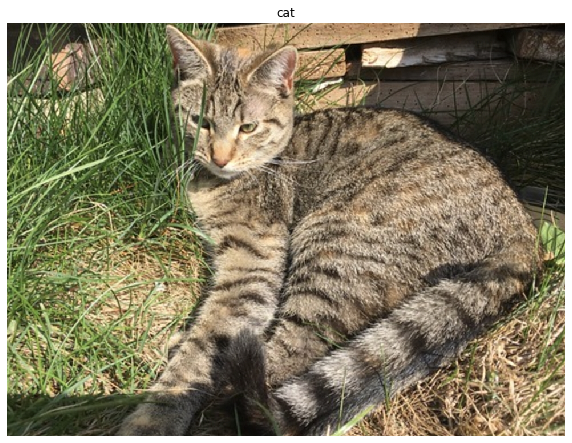

(724, 978, 3)


In [4]:
image1 = load('images/cat.jpg')

display(image1, 'cat')

print_stats(image1)

Return to this question after reading through the rest of the assignment. Find 2 more images to use as test cases in this assignment for all the following questions and display them below. Use your print_stats() function to display their height, width and number of channels. Explain *why* you have chosen each image.

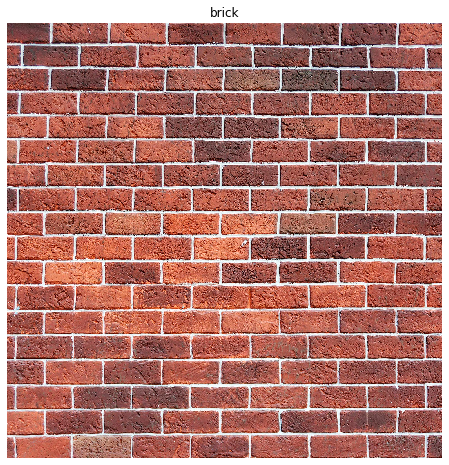

(1500, 1500, 3)


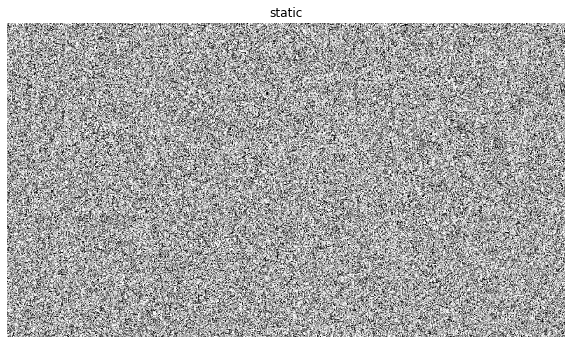

(720, 1280, 3)


In [5]:
### Your code to load and display your images here
image2 = load('images/brick.jpg')
display(image2, 'brick')
print_stats(image2)

image3 = load('images/static.jpg')
display(image3, 'static')
print_stats(image3)


***Your explanation of images here***

#### 1
The image of the brick wall was chosen because it has very distinct vertical and horizontal edges, which is a good way to test the edge detection function using the sobel filter in 3.4. It is also a repeating pattern, which makes for an interesting test case for testing correlation, as there should be many matches for a cropped sample of the image.

The image of the static was chosen because it can be used to showcase the smoothing that occurs when the gaussian filter is applied. It can also demonstrate the differences between applying a vertical or horizontal sobel filter, since it's a pseudorandom scattering of points with no pattern.

## Question 2: Image processing (20%)

Now that you have an image stored as a numpy array, let's try some operations on it.

1. Implement the `crop()` function in a1code.py. Use array slicing to crop the image.
2. Implement the `resize()` function in a1code.py.
3. Implement the `change_contrast()` function in a1code.py.
4. Implement the `greyscale()` function in a1code.py.
5. Implement the `binary()` function in a1code.py.

What do you observe when you change the threshold of the binary function?

Apply all these functions with different parameters on your own test images.

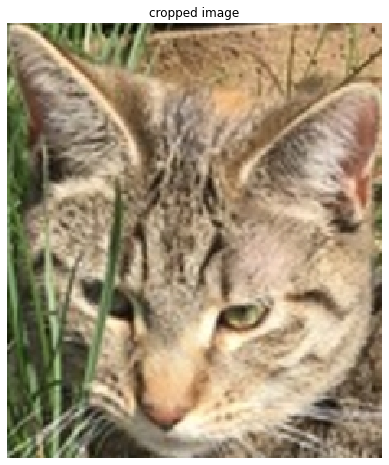

(267, 230, 3)


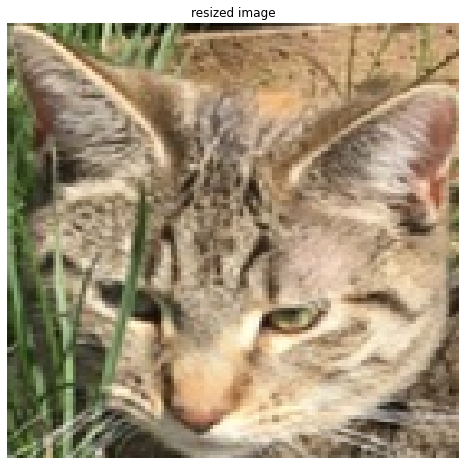

(133, 138, 3)


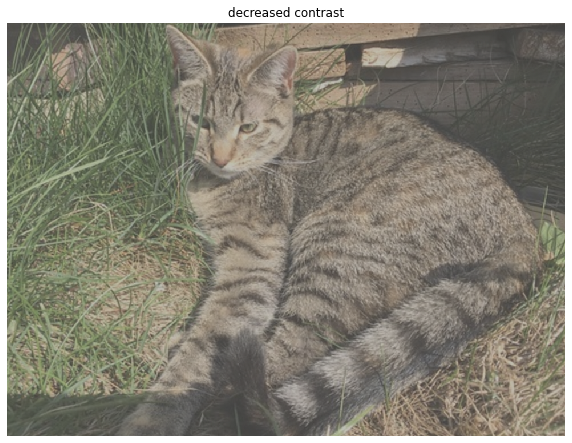

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


(724, 978, 3)


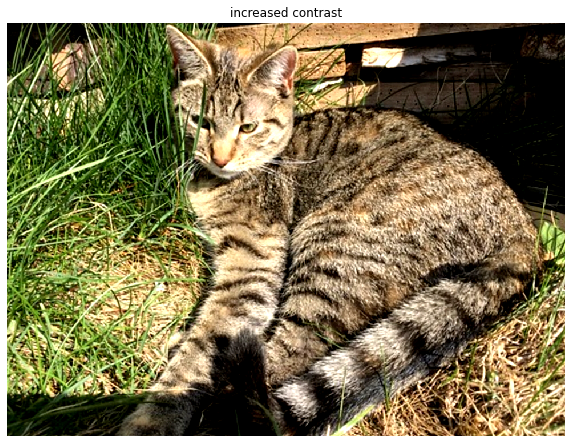

(724, 978, 3)


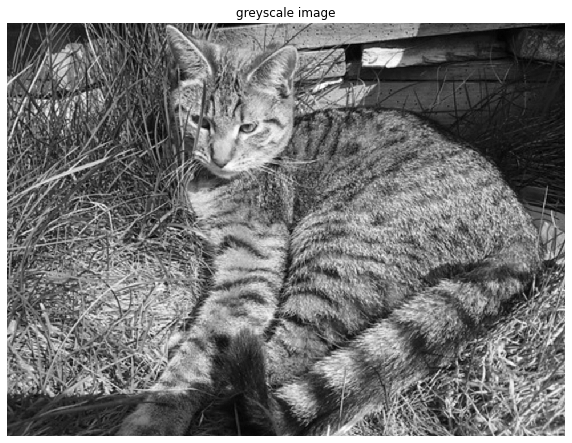

(724, 978)


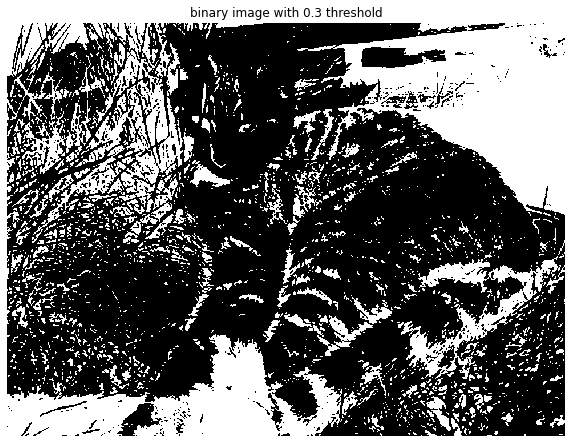

(724, 978)


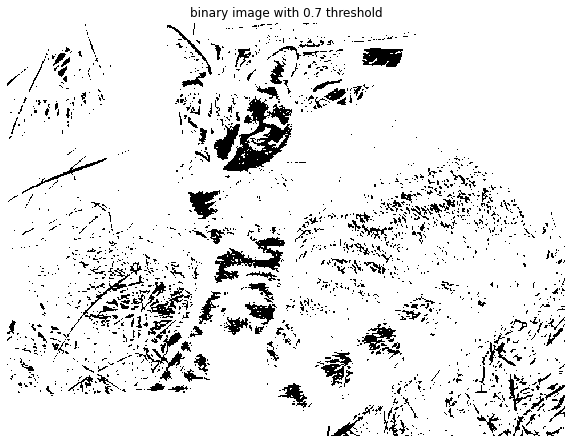

(724, 978)


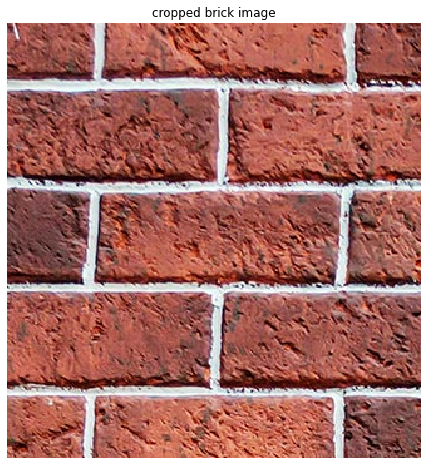

(347, 330, 3)


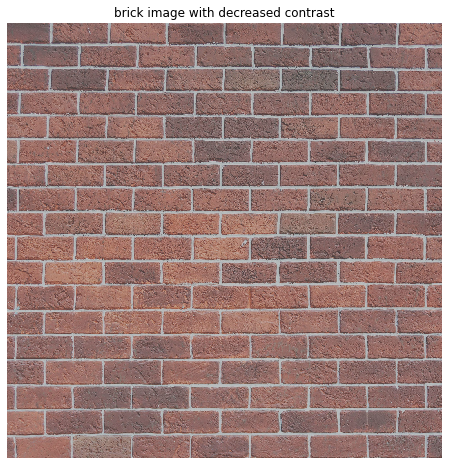

(1500, 1500, 3)


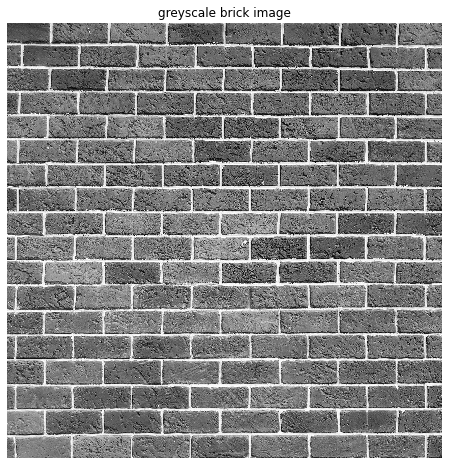

(1500, 1500)


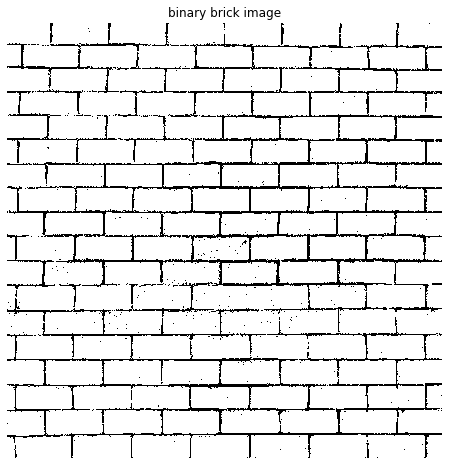

(1500, 1500)


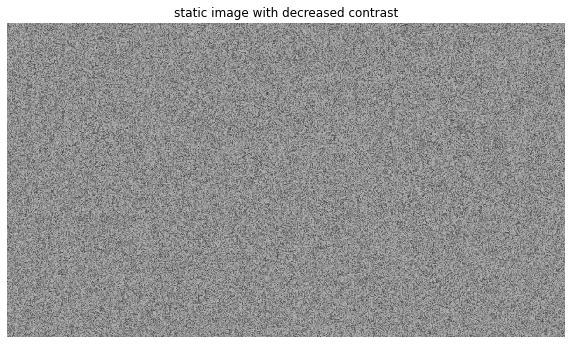

(720, 1280, 3)


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


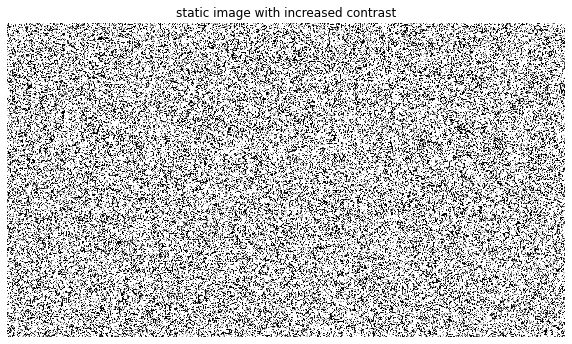

(720, 1280, 3)


In [6]:
# This should crop the head from the cat image
crop_img = crop(image1, 278, 5, 508, 272)
display(crop_img,'cropped image') 
print_stats(crop_img)

resize_img = resize(crop_img, 0.5, 0.6 )
display(resize_img,'resized image')
print_stats(resize_img)

contrast_img = change_contrast(image1, 0.5)
display(contrast_img,'decreased contrast')
print_stats(contrast_img)

contrast_img = change_contrast(image1, 1.5)
display(contrast_img,'increased contrast')
print_stats(contrast_img)

grey_img = greyscale(image1)
display(grey_img,'greyscale image')
print_stats(grey_img)

binary_img = binary(grey_img, 0.3)
display(binary_img,'binary image with 0.3 threshold')
print_stats(binary_img)

binary_img = binary(grey_img, 0.7)
display(binary_img,'binary image with 0.7 threshold')
print_stats(binary_img)

# Add your own tests here...
crop_brick = crop(image2, 278, 25, 608, 372)
display(crop_brick,'cropped brick image') 
print_stats(crop_brick)

contrast_brick = change_contrast(image2, 0.5)
display(contrast_brick,'brick image with decreased contrast')
print_stats(contrast_brick)

grey_brick = greyscale(image2)
display(grey_brick,'greyscale brick image')
print_stats(grey_brick)

binary_brick = binary(grey_brick, 0.8)
display(binary_brick,'binary brick image')
print_stats(binary_brick)

contrast_static1 = change_contrast(image3,0.4)
display(contrast_static1,'static image with decreased contrast')
print_stats(contrast_static1)

contrast_static2 = change_contrast(image3,4)
display(contrast_static2,'static image with increased contrast')
print_stats(contrast_static2)

## Question 3: Convolution (20%)

### 3.1 2D convolution

Using the definition of 2D convolution from week 1, implement the convolution operation in the function `conv2D()` in a1code.py.


In [7]:
test_conv2D()

### 3.2 RGB convolution

In the function `conv` in a1code.py, extend your function `conv2D` to work on RGB images, by applying the 2D convolution to each channel independently. 

### 3.3 Gaussian filter convolution

Use the `gauss2D` function provided in a1code.py to create a Gaussian kernel, and apply it to your images with convolution. You will obtain marks for trying different tests and analysing the results, for example:

- try varying the image size, and the size and variance of the filter  
- subtract the filtered image from the original - this gives you an idea of what information is lost when filtering

What do you observe and why?

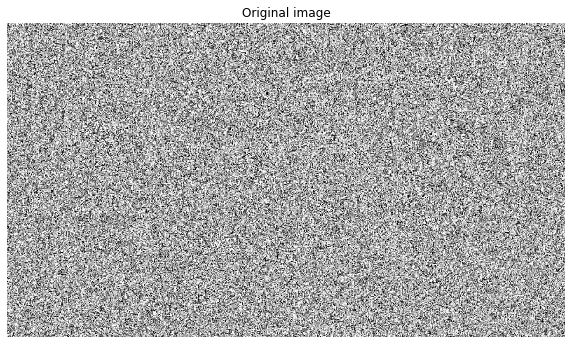

(720, 1280, 3)


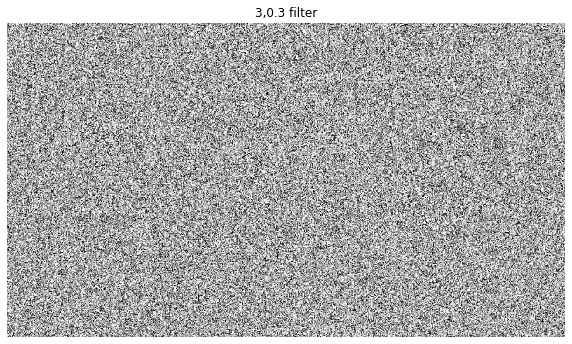

(720, 1280, 3)


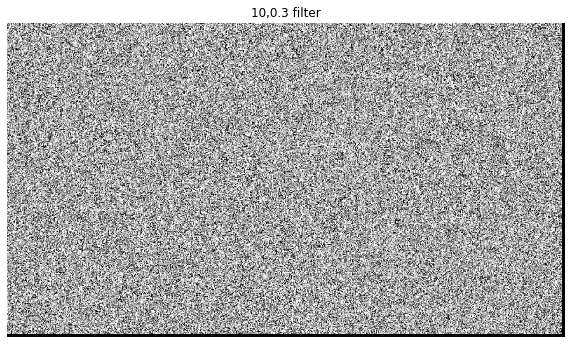

(720, 1280, 3)


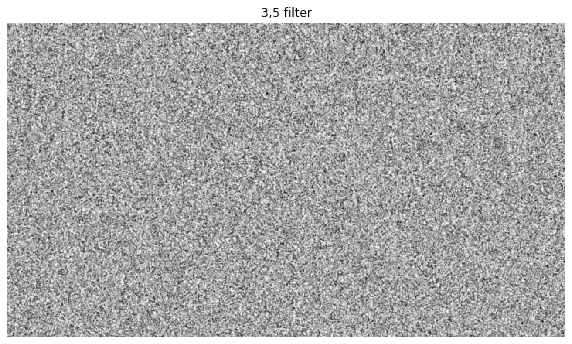

(720, 1280, 3)


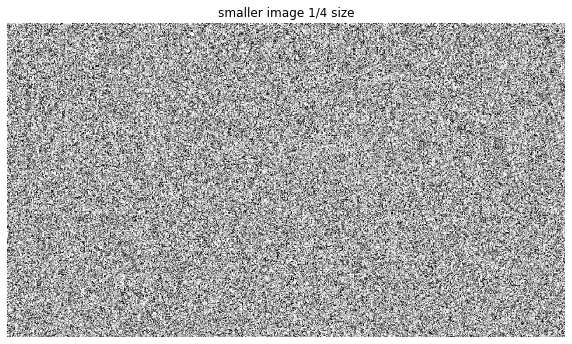

(360, 640, 3)


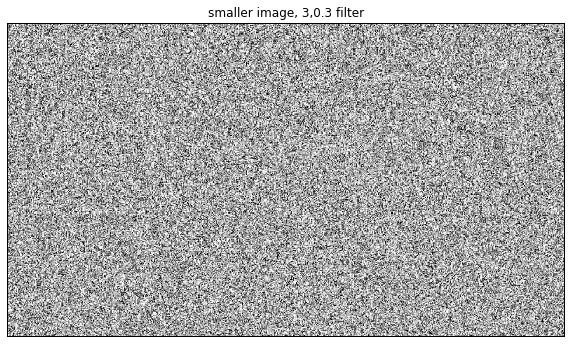

(360, 640, 3)


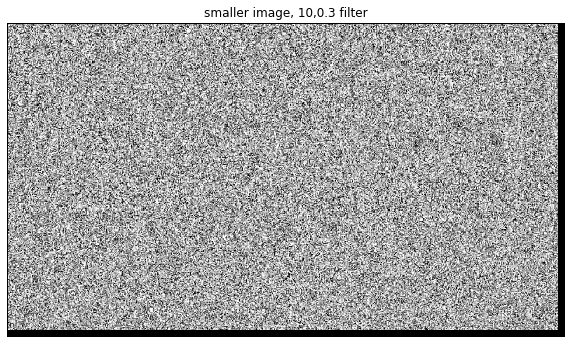

(360, 640, 3)


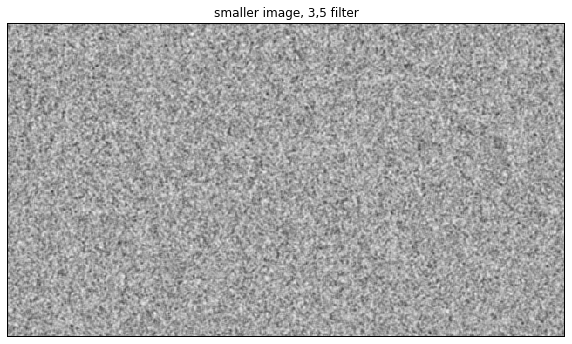

(360, 640, 3)


In [8]:
# original image
display(image3,'Original image')
print_stats(image3)

# 3,0.3 filter
gauss_filter1 = gauss2D(3,0.3)
gauss1static1 = conv(image3,gauss_filter1)
display(gauss1static1,'3,0.3 filter')
print_stats(gauss1static1)

# 10,0.3 filter
gauss_filter2 = gauss2D(10,0.3)
gauss2static1 = conv(image3,gauss_filter2)
display(gauss2static1,'10,0.3 filter')
print_stats(gauss2static1)

# 3,2 filter
gauss_filter3 = gauss2D(3,2)
gauss3static1 = conv(image3,gauss_filter3)
display(gauss3static1,'3,5 filter')
print_stats(gauss3static1)

# 1/4 smaller image size
resize_static = resize(image3, 0.5, 0.5)
display(resize_static,'smaller image 1/4 size')
print_stats(resize_static)

# 3,0.3 filter
gauss1static2 = conv(resize_static,gauss_filter1)
display(gauss1static2,'smaller image, 3,0.3 filter')
print_stats(gauss1static2)

# 10,0.3 filter
gauss2static2 = conv(resize_static,gauss_filter2)
display(gauss2static2,'smaller image, 10,0.3 filter')
print_stats(gauss2static2)

# 3,2 filter
gauss3static2 = conv(resize_static,gauss_filter3)
display(gauss3static2,'smaller image, 3,5 filter')
print_stats(gauss3static2)

#### 3.3
When the size of the image is reduced, the effect of the gaussian filter is more pronounced. This is because information is already lost when resizing, and the gaussian filter on top of that will cause further loss of information, resulting in a blurrer image.

The size of the gaussian filter does not appear to have a significant effect on how blur the resulting image is, though it does affect how the image is blurred, giving more focus to certain parts, as a consequence of sampling more surrounding pixels.

On the other hand, the variance of the gaussian filter has a large impact on the how blur the resulting image is. The most obvious difference can be observed between the resized image with a filter of size 3 and variance 0.3 applied, and the resize image with a filter of size 3 and variance 5 applied. It can be clearly seen that a larger variance results in a blurrier image.

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


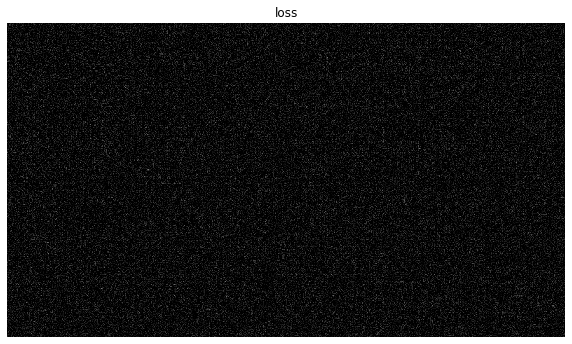

In [9]:
loss = image3 - gauss3static1
display(loss,'loss')

### 3.4 Sobel filters

Define a horizontal and vertical Sobel edge filter kernel and test them on your images. You will obtain marks for testing them and displaying results in interesting ways, for example:

- apply them to an image at different scales
- considering how to display positive and negative gradients
- apply different combinations of horizontal and vertical filters

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


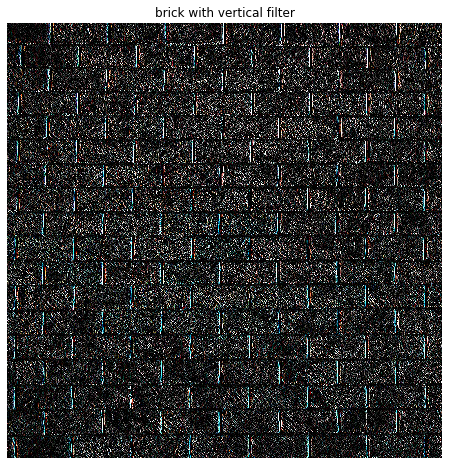

(1500, 1500, 3)


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


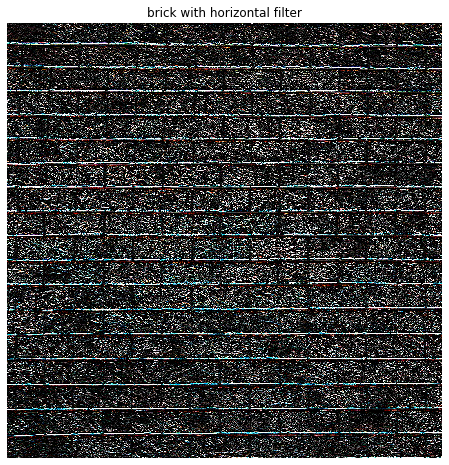

(1500, 1500, 3)


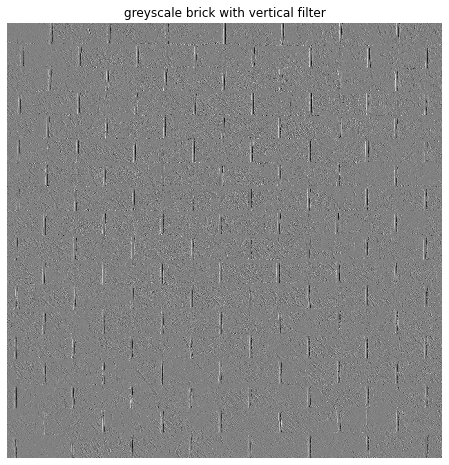

(1500, 1500)


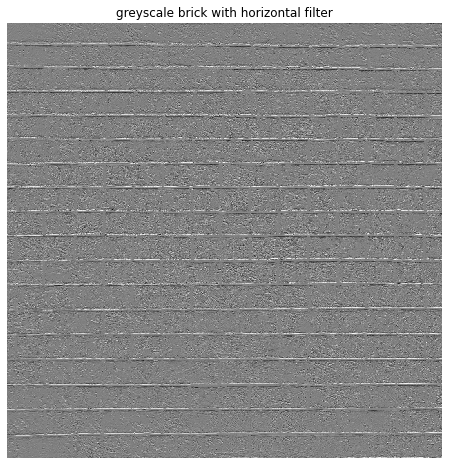

(1500, 1500)


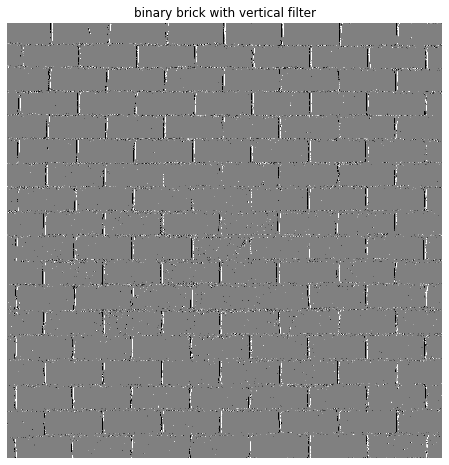

(1500, 1500)


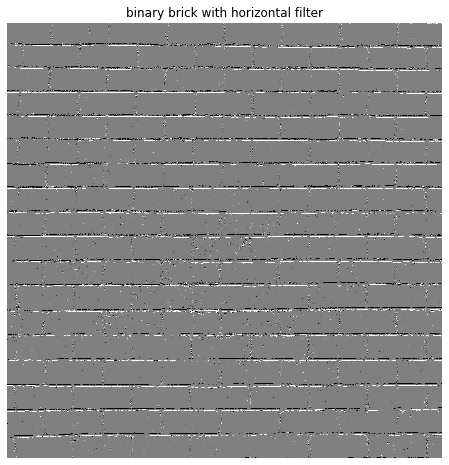

(1500, 1500)


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


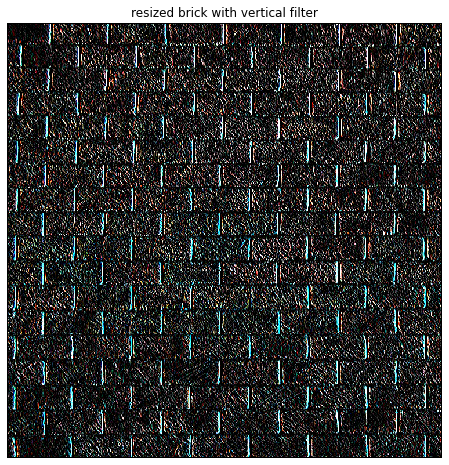

(750, 750, 3)


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


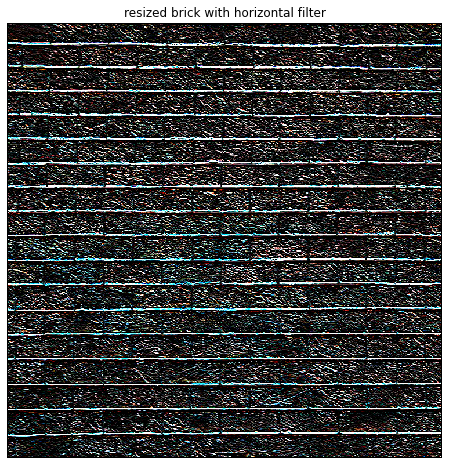

(750, 750, 3)


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


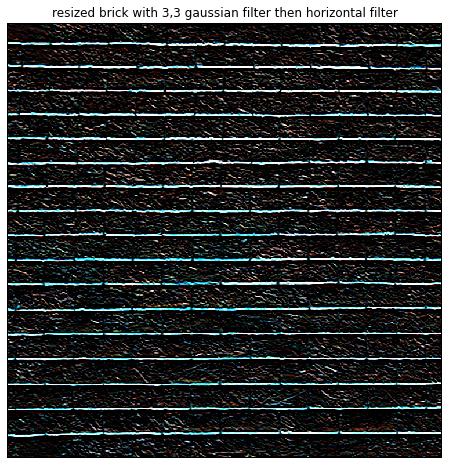

(750, 750, 3)


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


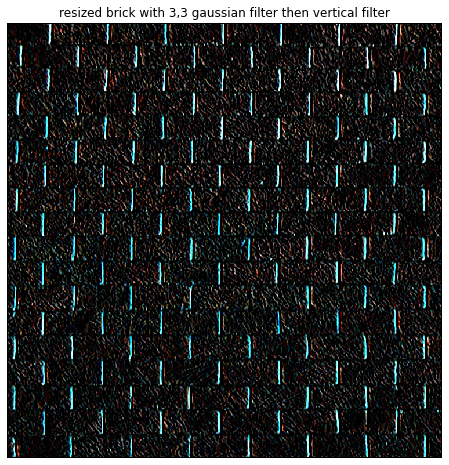

(750, 750, 3)


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


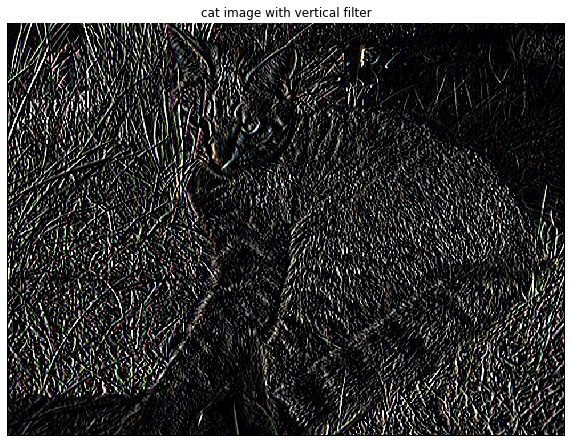

(724, 978, 3)


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


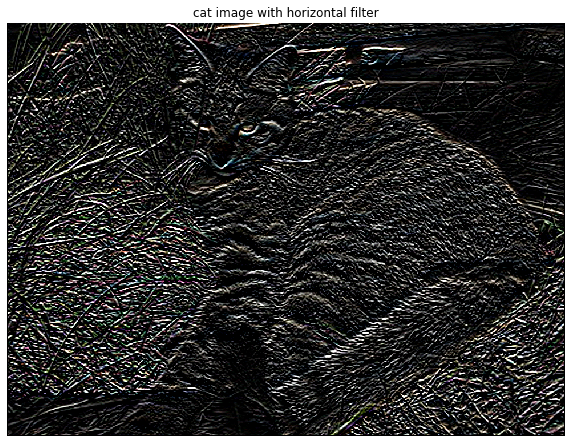

(724, 978, 3)


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


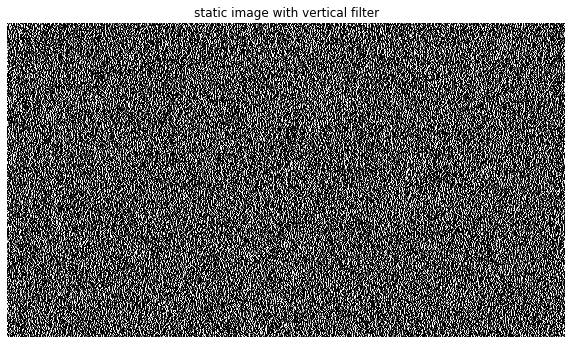

(720, 1280, 3)


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


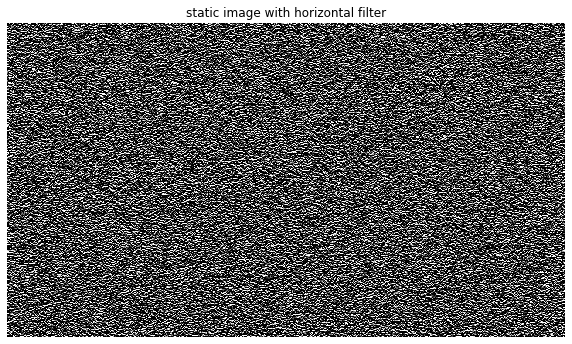

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


(720, 1280, 3)


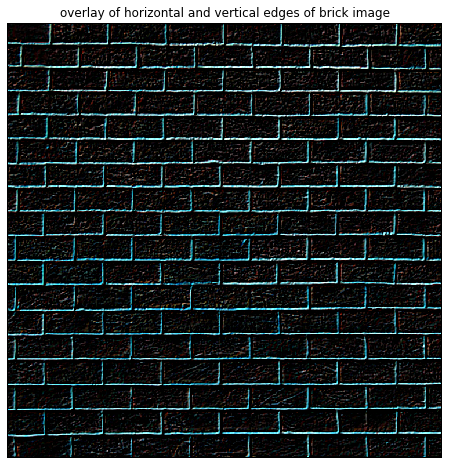

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


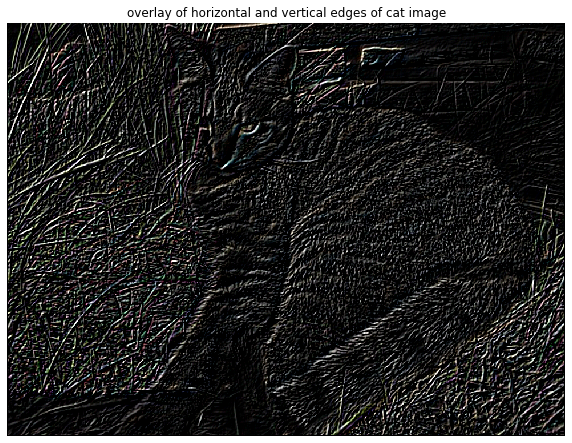

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


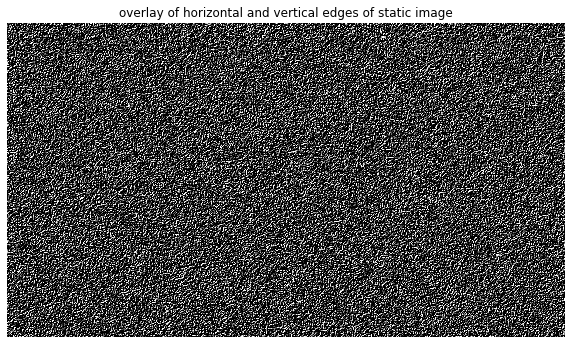

In [10]:
sobelv = np.array([[1, 0, -1], [2, 0, -2], [1, 0, -1]])
sobelh = np.array([[1, 2, 1], [0, 0, 0], [-1, -2, -1]])

# on rgb image
brick_sv = conv(image2,sobelv)
display(brick_sv,'brick with vertical filter')
print_stats(brick_sv)

brick_sh = conv(image2,sobelh)
display(brick_sh,'brick with horizontal filter')
print_stats(brick_sh)

# on greyscale image
gbrick_sv = conv(grey_brick,sobelv)
display(gbrick_sv,'greyscale brick with vertical filter')
print_stats(gbrick_sv)

gbrick_sh = conv(grey_brick,sobelh)
display(gbrick_sh,'greyscale brick with horizontal filter')
print_stats(gbrick_sh)

# on binary image
bbrick_sv = conv(binary_brick,sobelv)
display(bbrick_sv,'binary brick with vertical filter')
print_stats(bbrick_sv)

bbrick_sh = conv(binary_brick,sobelh)
display(bbrick_sh,'binary brick with horizontal filter')
print_stats(bbrick_sh)

# on resized image
resize_brick = resize(image2, 0.5, 0.5)
rbrick_sv = conv(resize_brick,sobelv)
display(rbrick_sv,'resized brick with vertical filter')
print_stats(rbrick_sv)

rbrick_sh = conv(resize_brick,sobelh)
display(rbrick_sh,'resized brick with horizontal filter')
print_stats(rbrick_sh)

# applying gaussian then horizontal
gaussian = gauss2D(3,3)
grbrick = conv(resize_brick,gaussian)
grhbrick = conv(grbrick,sobelh)
display(grhbrick,'resized brick with 3,3 gaussian filter then horizontal filter')
print_stats(grhbrick)

# applying gaussian then vertical
grvbrick = conv(grbrick,sobelv)
display(grvbrick,'resized brick with 3,3 gaussian filter then vertical filter')
print_stats(grvbrick)

#applying horizontal and vertical to cat
cat_sv = conv(image1,sobelv)
display(cat_sv,'cat image with vertical filter')
print_stats(cat_sv)

cat_sh = conv(image1,sobelh)
display(cat_sh,'cat image with horizontal filter')
print_stats(cat_sh)

#applying horizontal and vertical to static
static_sv = conv(image3,sobelv)
display(static_sv,'static image with vertical filter')
print_stats(static_sv)

static_sh = conv(image3,sobelh)
display(static_sh,'static image with horizontal filter')
print_stats(static_sh)

#overlay vertical and horizontal edges of all images
brickedge = grvbrick*0.5 + grhbrick*0.5
display(brickedge,'overlay of horizontal and vertical edges of brick image')

catedge = cat_sv*0.5 + cat_sh*0.5
display(catedge,'overlay of horizontal and vertical edges of cat image')

staticedge = static_sh*0.5 + static_sv*0.5
display(staticedge,'overlay of horizontal and vertical edges of static image')

***Your comments/analysis of your results here...***

#### 3.4
By applying the sobel filter on the original RGB image, the resulting image is very noisy, as there are many small edges that can be detected in the original. By converting the original to greyscale or binary, the noise is mitigated. Since there is only one channel for color, edges are detected more easily by the sobel filter. By applying the gaussian filter first, then using the sobel filter, the noise can be further reduced, since any small irregularities in the original image will be smoothed over by the gaussian filter.

Since the image of the cat does not contain many distinctive horizontal and vertical edges, and the edges are relatively smooth, the result of applying the horizontal and vertical sobel filters are similar. The image of static, as expected, has very few edges, as it is a random scattering of black and white pixels.

By overlaying the results of the horizontal and vertical sobel filter at 50% opacity each, we are able to find the edges within the original image, though there is quite a lot of noise and the edges are not very distinct, especially for the cat and static images.

## Question 4: Image sampling and pyramids (25%)

### 4.1 Image Sampling

Apply your `resize()` function to reduce an image (I) to 0.125 height and width, and then to enlarge the image back to its original size to get an image (I'). Display and compare I and I'.

Apply a Sobel filter to I to get the edge image E.

Apply a Sobel filter to I' to get the edge image E'.

Display and compare E and E'. What do you observe and why?


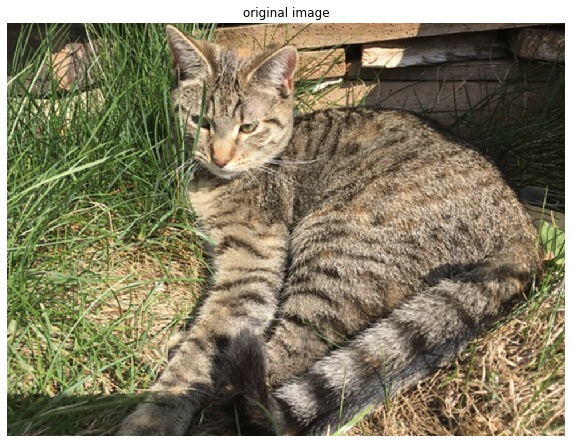

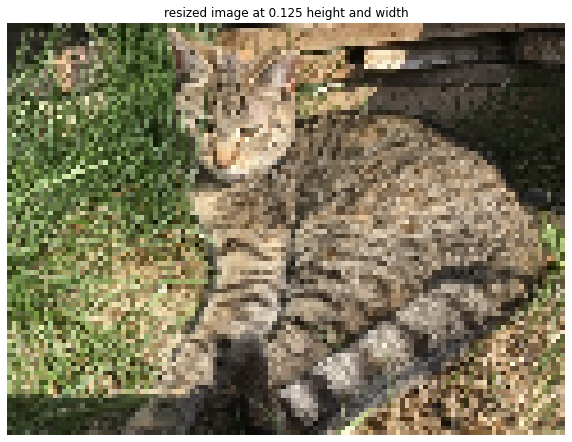

(90, 122, 3)


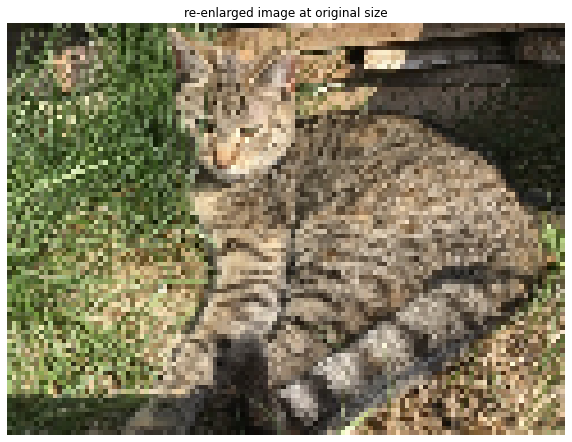

(720, 976, 3)


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


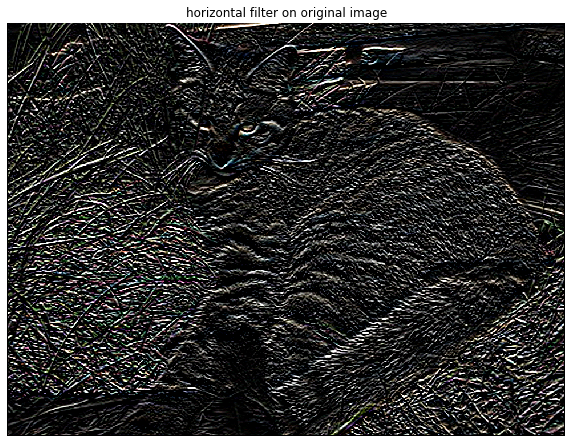

(724, 978, 3)


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


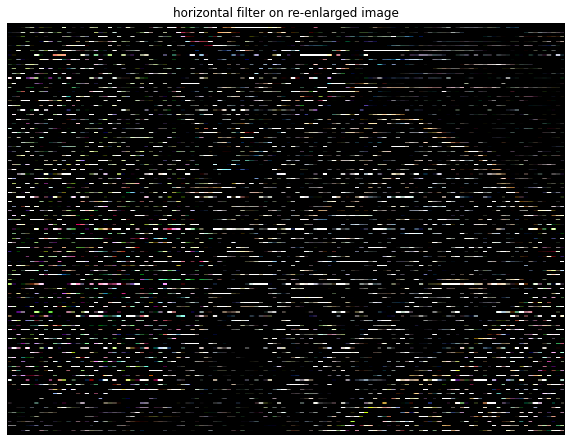

(720, 976, 3)


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


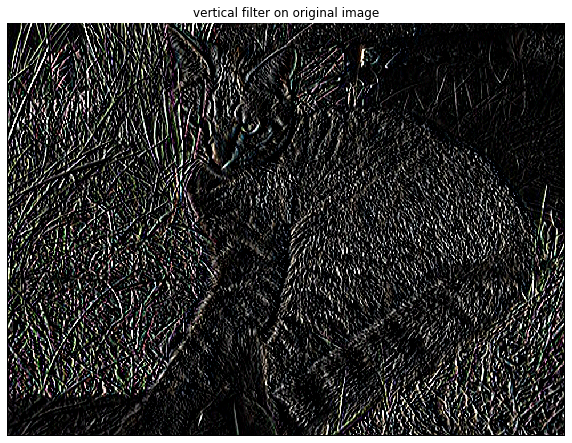

(724, 978, 3)


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


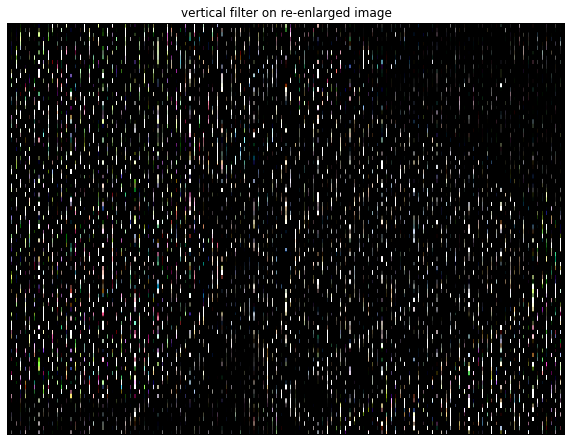

(720, 976, 3)


In [11]:
# original image
display(image1,'original image')

# resized image
resize_image1 = resize(image1,0.125,0.125)
display(resize_image1,'resized image at 0.125 height and width')
print_stats(resize_image1)

# enlarge back
enlarge_image1 = resize(resize_image1,8,8)
display(enlarge_image1,'re-enlarged image at original size')
print_stats(enlarge_image1)

# apply horizontal sobel filter to I and I'
E = conv(image1,sobelh)
display(E,'horizontal filter on original image')
print_stats(E)

Eprime = conv(enlarge_image1,sobelh)
display(Eprime,'horizontal filter on re-enlarged image')
print_stats(Eprime)

# apply vertical sobel filter to I and I'
Ev = conv(image1,sobelv)
display(Ev,'vertical filter on original image')
print_stats(Ev)

Evprime = conv(enlarge_image1,sobelv)
display(Evprime,'vertical filter on re-enlarged image')
print_stats(Evprime)

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


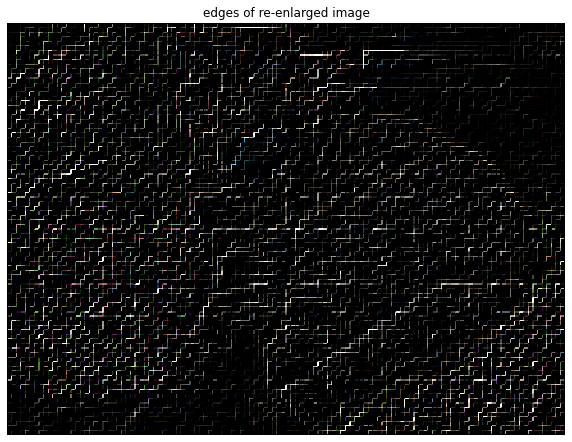

In [12]:
# combining horizontal sobel and vertical sobel results
edge = Eprime*0.5 + Evprime*0.5
display(edge,'edges of re-enlarged image')

***Your comments/analysis of your results here...***

#### 4.1
Since the sobel filter works by detecting variations in pixels to their neighbors, and the re-enlarged image has boxes of pixels which all have the same color value, the edges being detected are the boundaries between pixels of the resized image.

### 4.2 Image Pyramids 
Creat a Gaussian pyramid as described in week2's lecture on an image.

Apply a Gaussian kernel to an image I, and resize it with ratio 0.5, to get $I_1$. Repeat this step to get $I_2$, $I_3$ and $I_4$.

Display these four images following the zebra example shown in the lecture note.

What is your observation?

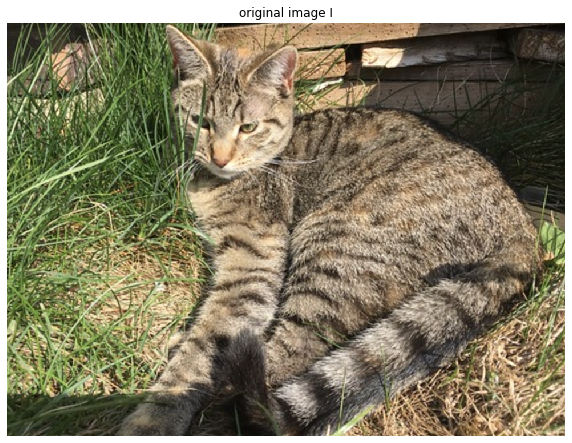

(724, 978, 3)


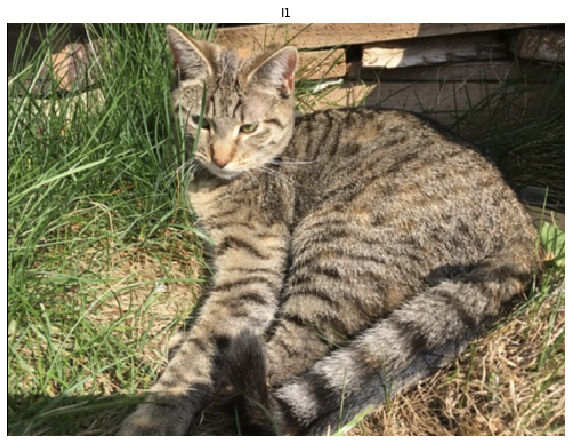

(362, 489, 3)


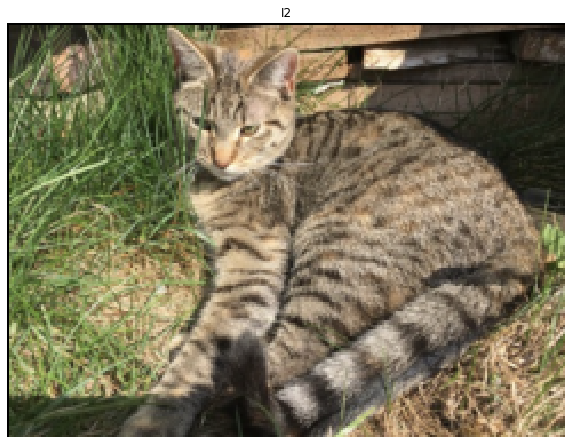

(181, 244, 3)


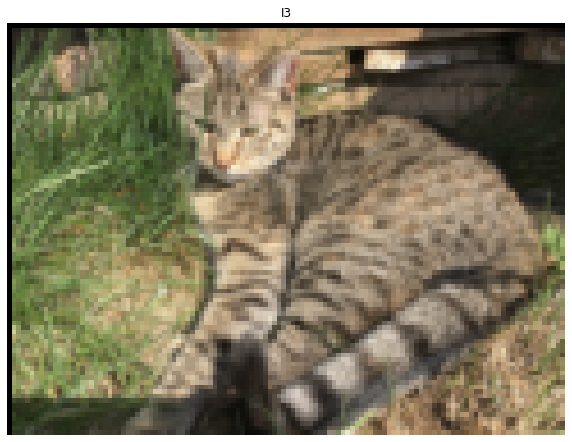

(90, 122, 3)


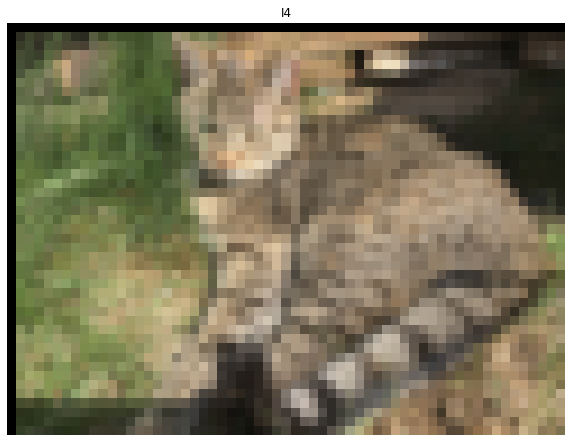

(45, 61, 3)


In [13]:
gkernel = gauss2D(3,0.8)
# original image I
display(image1,'original image I')
print_stats(image1)

gaussI = conv(image1,gkernel)
# I1
I1 = resize(gaussI,0.5,0.5)
display(I1,'I1')
print_stats(I1)

gaussI1 = conv(I1,gkernel)
# I2
I2 = resize(gaussI1,0.5,0.5)
display(I2,'I2')
print_stats(I2)

gaussI2 = conv(I2,gkernel)
# I3
I3 = resize(gaussI2,0.5,0.5)
display(I3,'I3')
print_stats(I3)

gaussI3 = conv(I3,gkernel)
# I4
I4 = resize(gaussI3,0.5,0.5)
display(I4,'I4')
print_stats(I4)

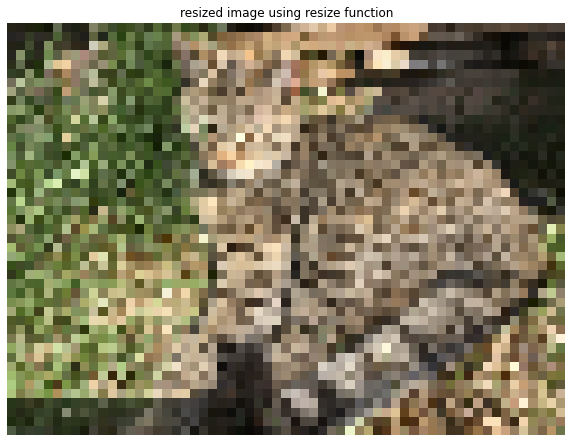

(45, 61, 3)


In [14]:
test = resize(image1,1/16,1/16)
display(test,'resized image using resize function')
print_stats(test)

#### 4.2
The gaussian pyramid applies a gaussian filter to the image and scales it down, repeating the process multiple times to generate a much smaller image while preserving much of the smoothness of the original image. As seen above, by directly compressing the image to the same size as the gaussian pyramid, the image is very grainy, and it is hard to distinguish what the original might have looked like. However, by using a gaussian pyramid, the image is much smoother.

## Question 5: Auto correlation (20%)

Recall from week 2 that cross-correlation is a measure of similarity between a template and an image. It is defined similarly to convolution.

### 5.1 Correlation function

Implement the function `corr()` in a1code.py, based on your convolution function. Hint: numpy's `flip()` function may be useful here.

### 5.2 Auto-correlation

We will experiment with *auto-correlation*, where the template patch is taken from the image it is being compared to. Use the cropped eye from Question 2 as your template. Calculate the correlation of that template with every location in the image, and display the output as an image. Where is the maximum similarity? (Hint: numpy functions `argmax()` and `unravel()` will be useful here). For simplicity, you can use a greyscale version of the image and template.

Is it what you expect? Why or why not?

### 5.3 Modified auto-correlation

Try modifying your correlation template or the base image in different ways, and analyse the effect on correlation results. For example:

- if you did not find the correct location in 5.2, try centering the template about its mean (i.e. subtracting the mean brightness from each pixel)
- if you did find the correct location in 5.2, try using `resize()` and `change_contrast()` on the image. Where does it fail?

As before you will obtain marks for coming up with interesting tests and analysis, and displaying your results clearly. 


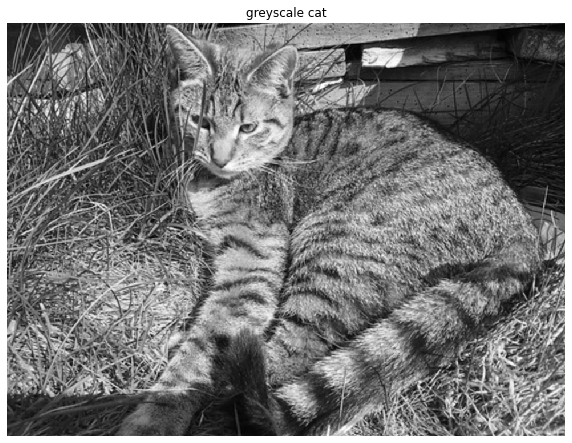

(724, 978)


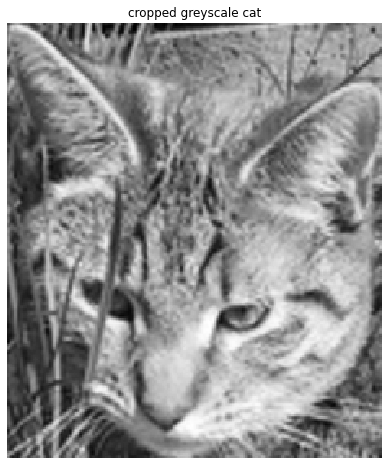

(267, 230)


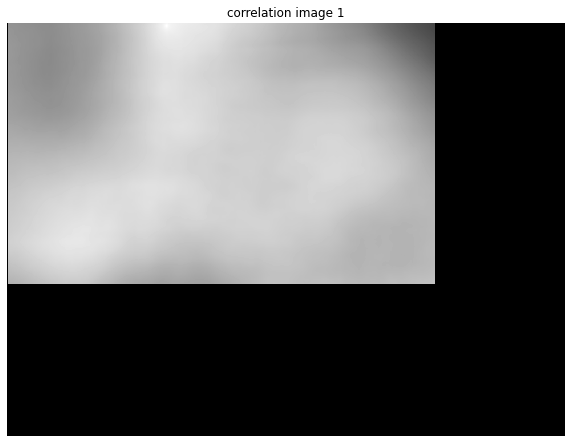

(724, 978)
(6, 279)


In [15]:
display(grey_img,'greyscale cat')
print_stats(grey_img)
greycrop = greyscale(crop_img)
display(greycrop,'cropped greyscale cat')
print_stats(greycrop)

corr1 = corr(grey_img,greycrop)
display(corr1,'correlation image 1')
print_stats(corr1)

location = np.unravel_index(np.argmax(corr1),(corr1.shape[0],corr1.shape[1]))
print(location)

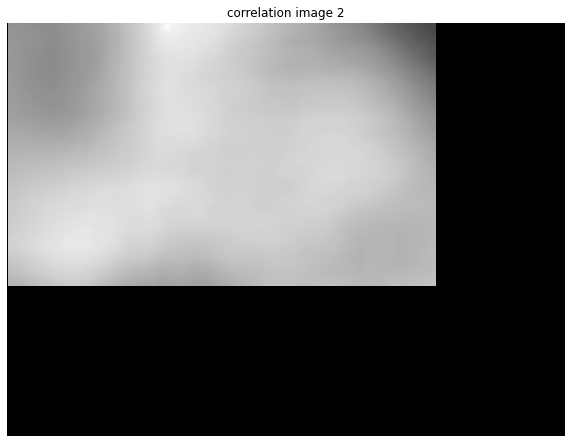

(362, 489)
(3, 140)


In [16]:
# location found
# resize
resize_grey = resize(grey_img,0.5,0.5)
resize_crop = resize(greycrop,0.5,0.5)

corr2= corr(resize_grey,resize_crop)
display(corr2,'correlation image 2')
print_stats(corr2)

location2 = np.unravel_index(np.argmax(corr2),(corr2.shape[0],corr2.shape[1]))
print(location2)
# location correct

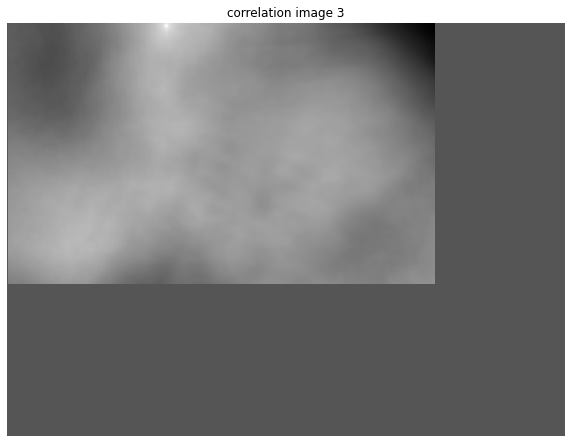

(724, 978)
(6, 279)


In [17]:
# location found
# resize
contrast_grey = change_contrast(grey_img,3)
contrast_crop = change_contrast(greycrop,3)

corr3= corr(contrast_grey,contrast_crop)
display(corr3,'correlation image 3')
print_stats(corr3)

location3 = np.unravel_index(np.argmax(corr3),(corr3.shape[0],corr3.shape[1]))
print(location3)
# location correct

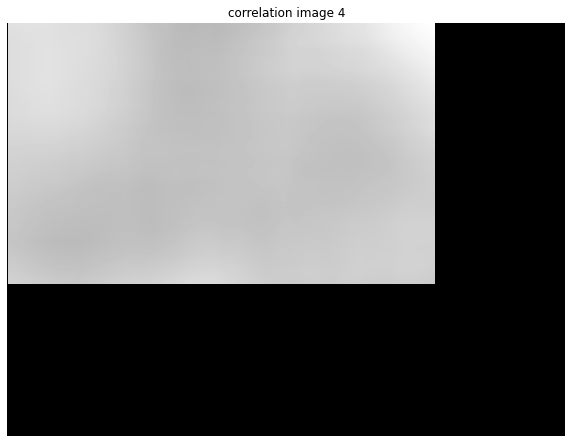

(724, 978)
(1, 749)


In [18]:
# location found
# resize
contrast_grey2 = change_contrast(grey_img,-0.5)
contrast_crop2 = change_contrast(greycrop,-0.5)

corr4= corr(contrast_grey2,contrast_crop2)
display(corr4,'correlation image 4')
print_stats(corr4)

location4 = np.unravel_index(np.argmax(corr4),(corr4.shape[0],corr4.shape[1]))
print(location4)
# location wrong

By changing the contrast of the greyscale image to negative, the correlation of the images surpassed 1 on the top right corner of the correlation image. Originally, the point where the image is the most correlated (i.e. where the crop came from) was the brightest point on the correlation image. Since the kernel was directly cropped from the original, the maximum brightness is 1. When the contrast of the images where changed, the correlation between the image and the kernel also reached the maximum value at some parts, resulting in the maximum similarity being found at the wrong location.